# **The Colorization Problem**

Our project focuses on automatic image captioning, a field that has witnessed significant advancements thanks to the capabilities of Machine Learning. Traditionally, image captioning was a labor-intensive process requiring extensive human effort. However, Machine Learning techniques have streamlined this process, making it more efficient and accurate. To achieve this, we leveraged the comprehensive COCO 2017 dataset to train our model. This rich dataset provided a vast amount of training data, allowing the model to develop robust image understanding and caption generation capabilities.
#The L* a* b* over RGB approach
The default way the colors in our images are stored is in a RGB format, where each pixel has a numeric value for 3 channels- The Red Channel (R), The Green Channel (G) and The Blue Channel (B). The most obvious approach to the problem would be to have our agent get trained to predict the numeric values of these three channels. Why it gets tedious though is three channels means prediction of a Rank 3 array, which makes the training process a lot more hit-and-trial and longer than it should be. This is where the L* a* b* colour space comes in. This too uses three channels, however, it's not the same case as RGB because here, the L* channel stands for the lightness channel, which just gives us the greyscale image of the original, and that already is our input! Now, all we need to do is predict the values for the a* and b* channels, which is a Rank 2 array.

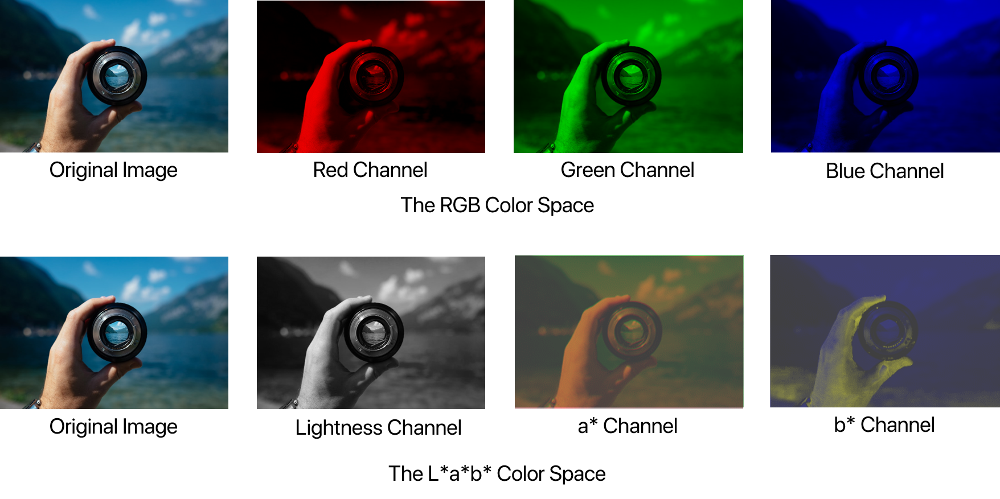

RBG Values can have 2563 choices, which goes more than 16 million choices, where as with L* a* b* images, that number goes down to around 65,000 which makes it a lot more efficient.

# **BASELINE MODEL**

In [ ]:
from google.colab import drive
drive.mount('/content/drive') # mounting Gdrive to save models

Mounted at /content/drive


In [ ]:
!wget http://images.cocodataset.org/zips/train2017.zip #download the dataset
!unzip train2017.zip -d /content/drive/MyDrive/vanGoghDataset/ #extract the dataset
!rm train2017.zip #delete the zip

Streaming output truncated to the last 5000 lines.
 extracting: /content/drive/MyDrive/vanGoghDataset/train2017/000000259556.jpg  
 extracting: /content/drive/MyDrive/vanGoghDataset/train2017/000000381931.jpg  
 extracting: /content/drive/MyDrive/vanGoghDataset/train2017/000000569592.jpg  
 extracting: /content/drive/MyDrive/vanGoghDataset/train2017/000000229396.jpg  
 extracting: /content/drive/MyDrive/vanGoghDataset/train2017/000000488990.jpg  
 extracting: /content/drive/MyDrive/vanGoghDataset/train2017/000000348684.jpg  
 extracting: /content/drive/MyDrive/vanGoghDataset/train2017/000000234031.jpg  
 extracting: /content/drive/MyDrive/vanGoghDataset/train2017/000000563584.jpg  
 extracting: /content/drive/MyDrive/vanGoghDataset/train2017/000000276069.jpg  
 extracting: /content/drive/MyDrive/vanGoghDataset/train2017/000000401194.jpg  
 extracting: /content/drive/MyDrive/vanGoghDataset/train2017/000000502089.jpg  
 extracting: /content/drive/MyDrive/vanGoghDataset/train2017/00000019

In [ ]:
# Training and Test Sets

import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

paths = glob.glob("/content/drive/MyDrive/vanGoghDataset/train2017/*.jpg") # all images in the dir
np.random.seed(123) # seeding for reproducable results
paths_subset = np.random.choice(paths, 10_000, replace=False) # randomly choosing 10,000 images
rand_idxs = np.random.permutation(10_000) # shuffling indexes
train_idxs = rand_idxs[:8000] # first 8000 images used to train
val_idxs = rand_idxs[8000:] # last 2000 images used to validate
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]

print(len(train_paths), len(val_paths))

8000 2000


In [ ]:
#Making Datasets and Dataloaders

SIZE = 256

class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])

        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE), Image.BICUBIC)

        self.split = split
        self.size = SIZE
        self.paths = paths

    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1

        return {'L': L, 'ab': ab}

    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')

data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']

print(Ls.shape, abs_.shape)
print(len(train_dl), len(val_dl))

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])
500 125


In [ ]:
# U-Net Architecture

class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False, innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf

        downconv = nn.Conv2d(input_c, ni, kernel_size=4, stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)

        if outermost:
            upconv = nn.ConvTranspose2d(ni*2, nf, kernel_size=4, stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up

        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4, stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + up

        else:
            upconv = nn.ConvTranspose2d(ni*2, nf, kernel_size=4, stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up

        self.model = nn.Sequential(*model)

    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)

    def forward(self, x):
        return self.model(x)

# **U-Net Architecture**
This is a rather hard to explain part but I will try my best. This generator was proposed in one of the research papers that I have mentioned. It uses a U-Net as the generator of our GAN. Our older Generator used to use CNN training method to recognise patterns in images and fill them with different colors, and it worked amazingly well, so we didn't want to change it too much. So, this generator suited our needs very well since U-Net is still a type of CNN which does not differ too much from our Generator BotRoss from version 2. The important thing here to understand is that the U-Net from the middle part of it adds down-sampling and up-sampling modules to the left and right of the middle module respectively at each step until it reaches the input module and the output module.

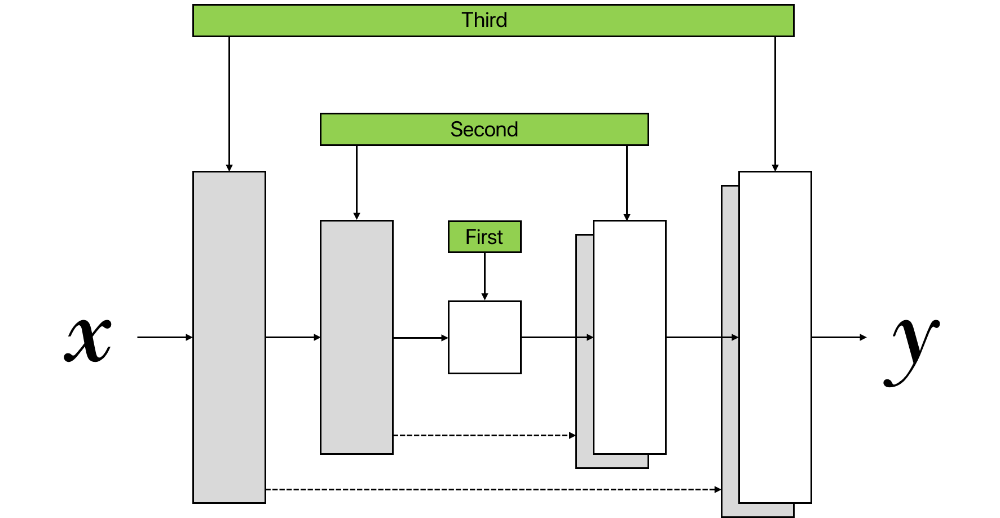

The green rectangles show the order in which the related modules are built with the code. The U-Net we will build has more layers than what is depicted in this image but it suffices to give you the idea. Also notice in the code that we are going 8 layers down, so if we start with a 256 by 256 image, in the middle of the U-Net we will get a 1 by 1 (256 / 2⁸) image and then it gets up-sampled to produce a 256 by 256 image (with two channels).

# **Discriminator**
We are using a “Patch” Discriminator here. In a vanilla discriminator, the model outputs one number (a scaler) which represents how much the model thinks the input (which is the whole image) is real (or fake). In a patch discriminator, the model outputs one number for every patch of say 70 by 70 pixels of the input image and for each of them decides whether it is fake or not separately. Using such a model for the task of colorization seems reasonable to me because the local changes that the model needs to make are really important and maybe deciding on the whole image as in vanilla discriminator cannot take care of the subtleties of this task. Here, the model’s output shape is 30 by 30 but it does not mean that our patches are 30 by 30. The actual patch size is obtained when you compute the receptive field of each of these 900 (30 multiplied by 30) output numbers which in our case will be 70 by 70.

In [ ]:
# Setting up the discriminator

class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2)
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)

    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

In [ ]:
# printing its blocks
print(PatchDiscriminator(input_c=3))

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

In [ ]:
# and the output shape
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

# **GANs Loss**
#A Deeper Dive into the Network
Let's take a look at the math. Consider x as the greyscale image, z as input noise for generator and y as the 2 channel output we want from the generator (The a* and b* color channels). Also, G is the generator model and D is the discriminator. Then the total loss for our GAN will be:

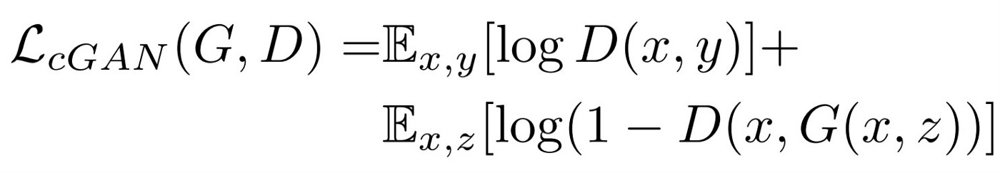

Notice that x is given to both models which is the condition we introduce two both players of this game. Actually, we are not going to feed a “n” dimensional vector of random noise to the generator as you might expect but the noise is introduced in the form of dropout layers in the generator architecture.

#### Optimising the Loss Function
The earlier loss function helps to produce good-looking colorful images that seem real, but to further help the models and introduce some supervision in our task, we combine this loss function with mean absolute error of the predicted colors compared with the actual colors:
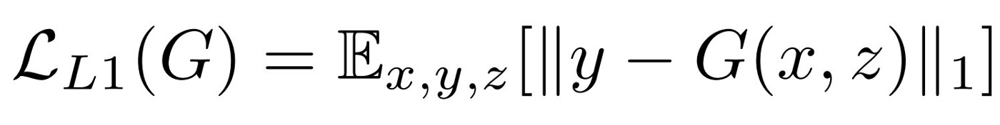
<br><br>
If we use mean absolute error loss, or L1 loss alone, the model still learns to colorize the images but it will be conservative and most of the time uses colors like “gray” or “brown” because when it doubts which color is the best, it takes the average and uses these colors to reduce the L1 loss as much as possible. Also, the L1 Loss is preferred over L2 loss (or mean squared error) because it reduces that effect of producing gray-ish images. So, our combined loss function will be:
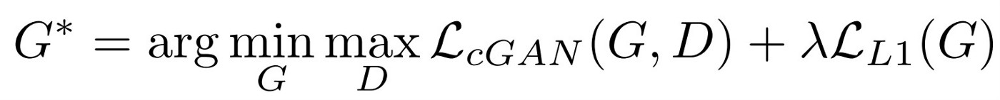
<br><br>
where ***λ*** is a coefficient to balance the contribution of the two losses to the final loss (of course the discriminator loss does not involve the L1 loss).

In [ ]:
# Here we find the GAN Loss of our model and register some tensors for real and fake which give output either 0 or 1 to compute the loss

class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()

    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)

    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

In [ ]:
# initialise the model with a standard deviation of 0.02 and mean of 0.0 which are hyperparameter given in the paper

def init_weights(net, init='norm', gain=0.02):

    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')

            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)

    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

In [ ]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4,
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()

        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1

        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))

    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad

    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)

    def forward(self):
        self.fake_color = self.net_G(self.L)

    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()

    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()

    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()

        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

model = MainModel()

model initialized with norm initialization
model initialized with norm initialization


In [ ]:
#log the losses of our network so that we can visualise the results during our training

class AverageMeter:
    def __init__(self):
        self.reset()

    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3

    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()

    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """

    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)

def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")

def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

In [ ]:
# Training Function
def train_model(model, train_dl, epochs, display_every=200):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data)
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 1/10
Iteration 200/500
loss_D_fake: 0.48004
loss_D_real: 0.49923
loss_D: 0.48964
loss_G_GAN: 1.50763
loss_G_L1: 9.53628
loss_G: 11.04391


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 22 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return func(*args, **kwargs)


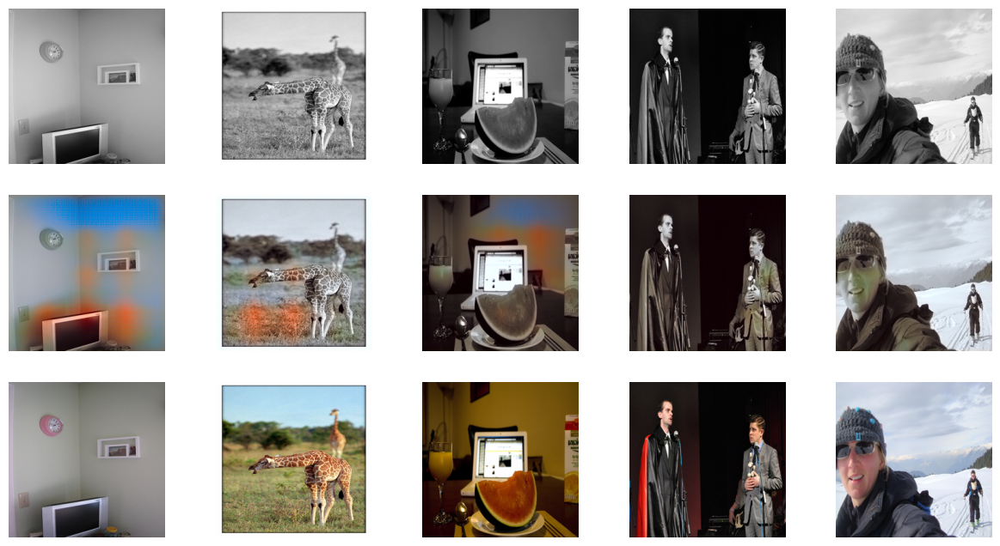


Epoch 1/10
Iteration 400/500
loss_D_fake: 0.48304
loss_D_real: 0.50009
loss_D: 0.49156
loss_G_GAN: 1.51978
loss_G_L1: 9.93536
loss_G: 11.45514


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 119 pixels
  return func(*args, **kwargs)


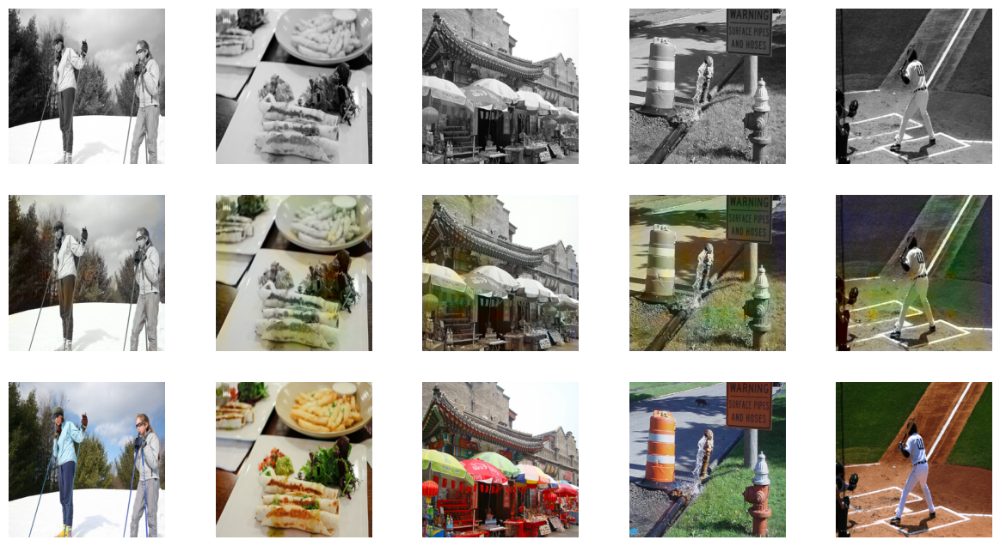

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 2/10
Iteration 200/500
loss_D_fake: 0.51448
loss_D_real: 0.56207
loss_D: 0.53827
loss_G_GAN: 1.36470
loss_G_L1: 10.48109
loss_G: 11.84579


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 47 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return func(*args, **kwargs)


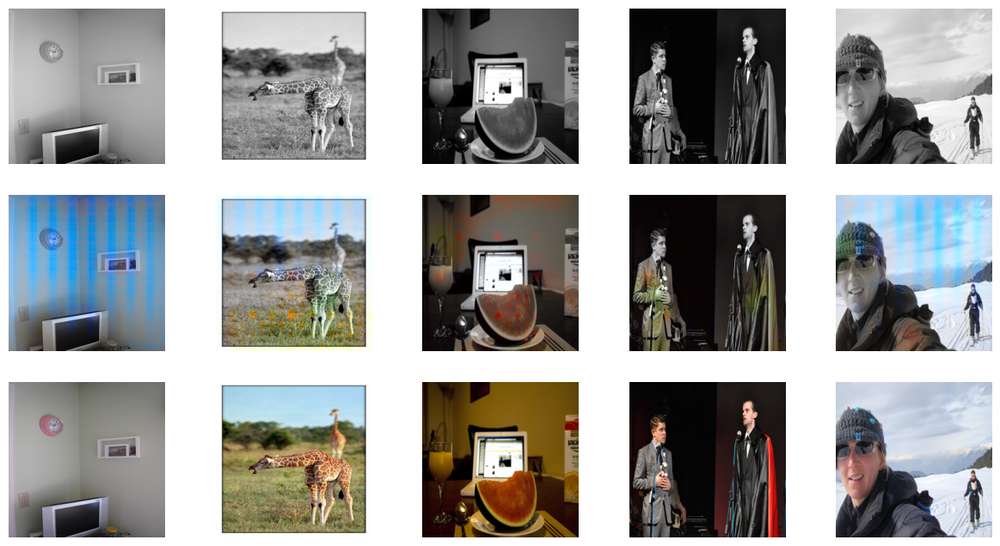


Epoch 2/10
Iteration 400/500
loss_D_fake: 0.51297
loss_D_real: 0.55631
loss_D: 0.53464
loss_G_GAN: 1.33914
loss_G_L1: 10.45772
loss_G: 11.79686


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 20 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 285 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 96 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 143 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 40 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 272 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_

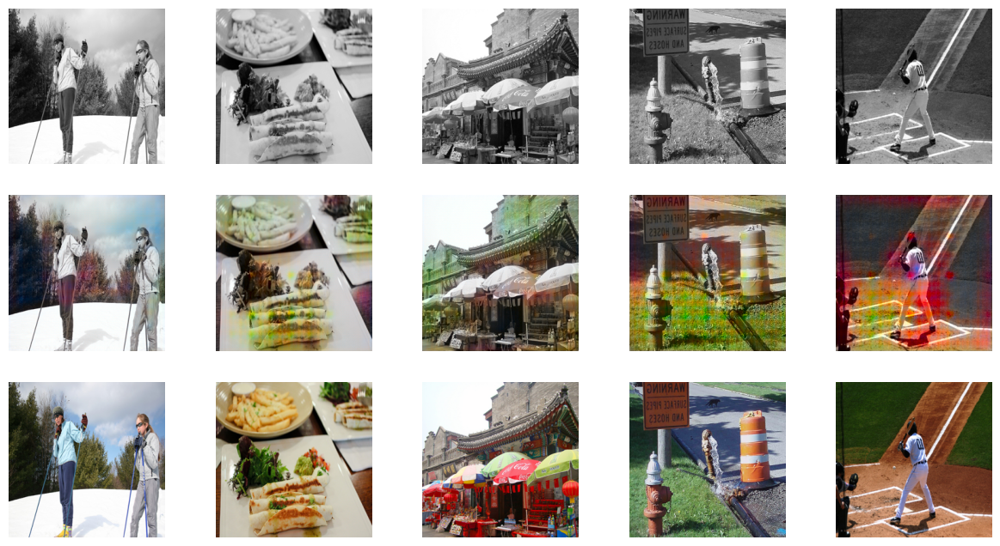

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 3/10
Iteration 200/500
loss_D_fake: 0.51305
loss_D_real: 0.57553
loss_D: 0.54429
loss_G_GAN: 1.27921
loss_G_L1: 10.47248
loss_G: 11.75169


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 23 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 51 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 78 pixels
  return func(*args, **kwargs)


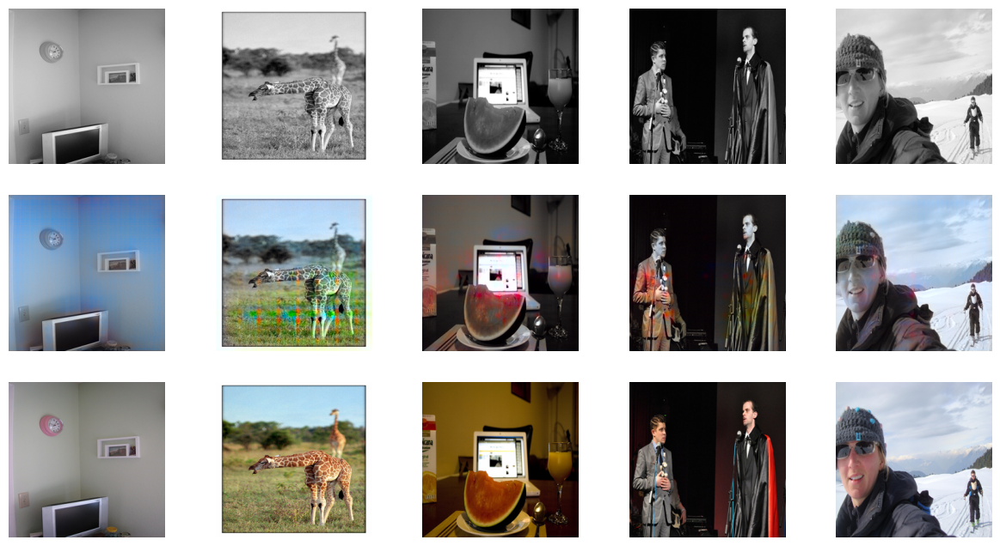


Epoch 3/10
Iteration 400/500
loss_D_fake: 0.52052
loss_D_real: 0.57698
loss_D: 0.54875
loss_G_GAN: 1.25940
loss_G_L1: 10.44097
loss_G: 11.70037


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 248 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 19 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 34 pixels
  return func(*args, **kwargs)


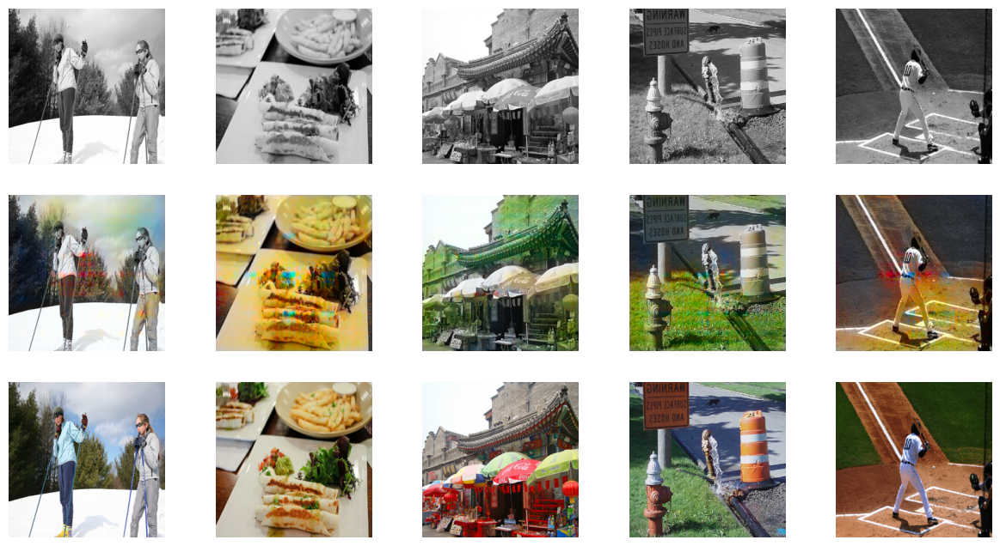

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 4/10
Iteration 200/500
loss_D_fake: 0.52511
loss_D_real: 0.59349
loss_D: 0.55930
loss_G_GAN: 1.22597
loss_G_L1: 10.32902
loss_G: 11.55499


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 69 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return func(*args, **kwargs)


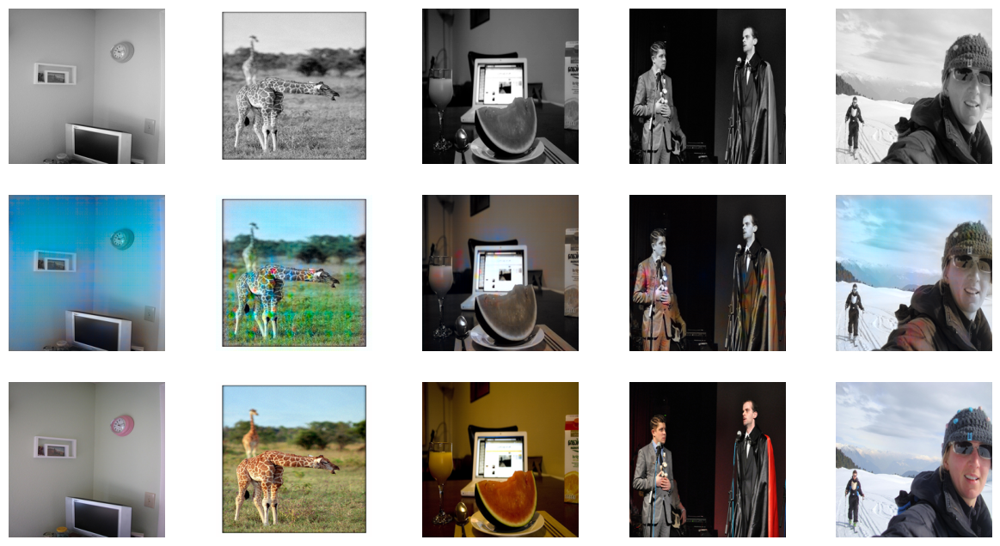


Epoch 4/10
Iteration 400/500
loss_D_fake: 0.52276
loss_D_real: 0.58119
loss_D: 0.55197
loss_G_GAN: 1.22942
loss_G_L1: 10.33789
loss_G: 11.56732


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return func(*args, **kwargs)


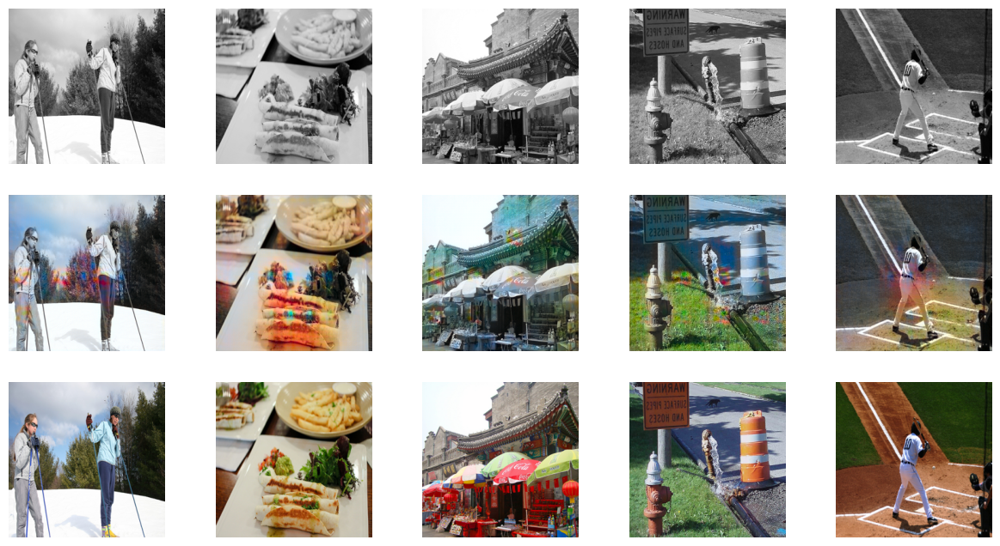

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 5/10
Iteration 200/500
loss_D_fake: 0.52410
loss_D_real: 0.58823
loss_D: 0.55616
loss_G_GAN: 1.23204
loss_G_L1: 10.25882
loss_G: 11.49086


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 28 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 62 pixels
  return func(*args, **kwargs)


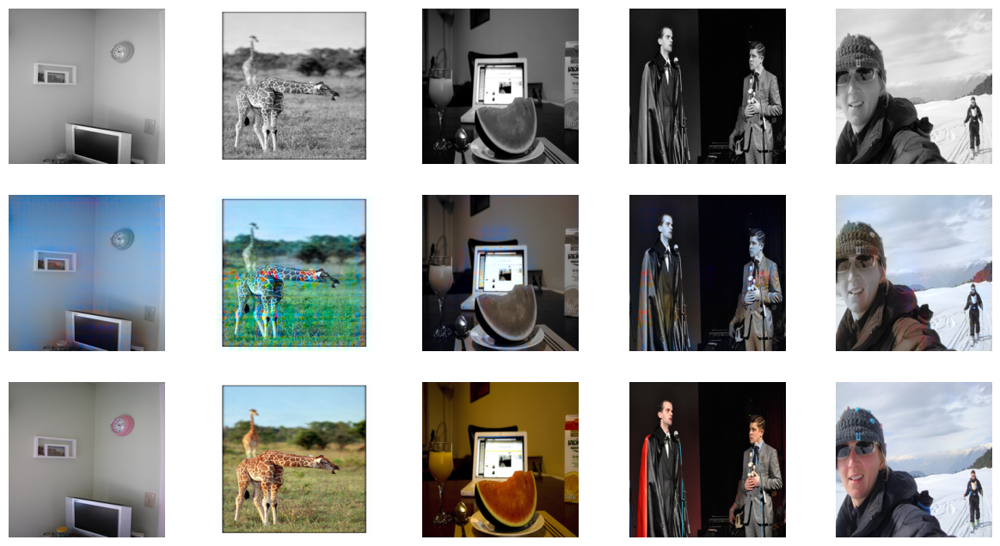


Epoch 5/10
Iteration 400/500
loss_D_fake: 0.51977
loss_D_real: 0.57779
loss_D: 0.54878
loss_G_GAN: 1.23556
loss_G_L1: 10.28076
loss_G: 11.51632


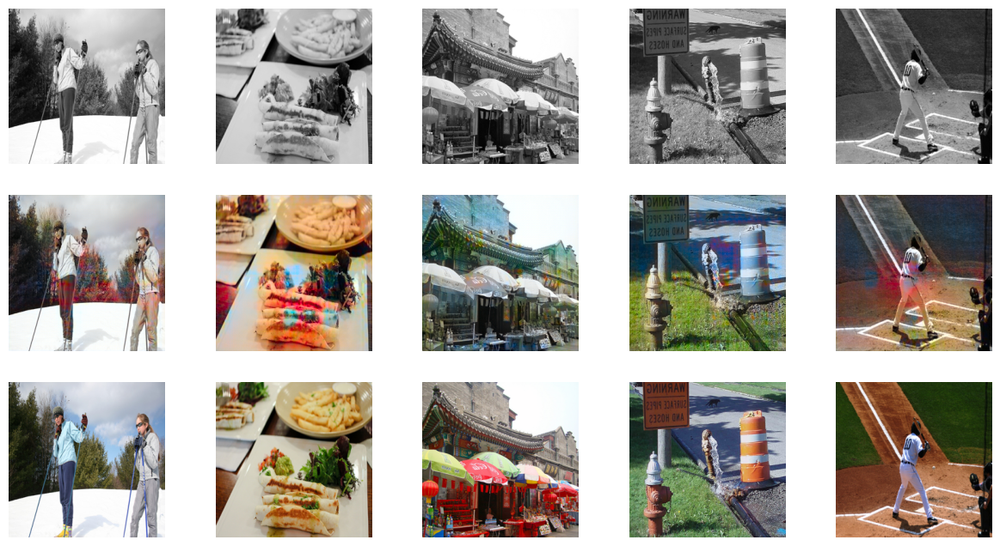

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 6/10
Iteration 200/500
loss_D_fake: 0.52765
loss_D_real: 0.59732
loss_D: 0.56248
loss_G_GAN: 1.21854
loss_G_L1: 10.19053
loss_G: 11.40907


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return func(*args, **kwargs)


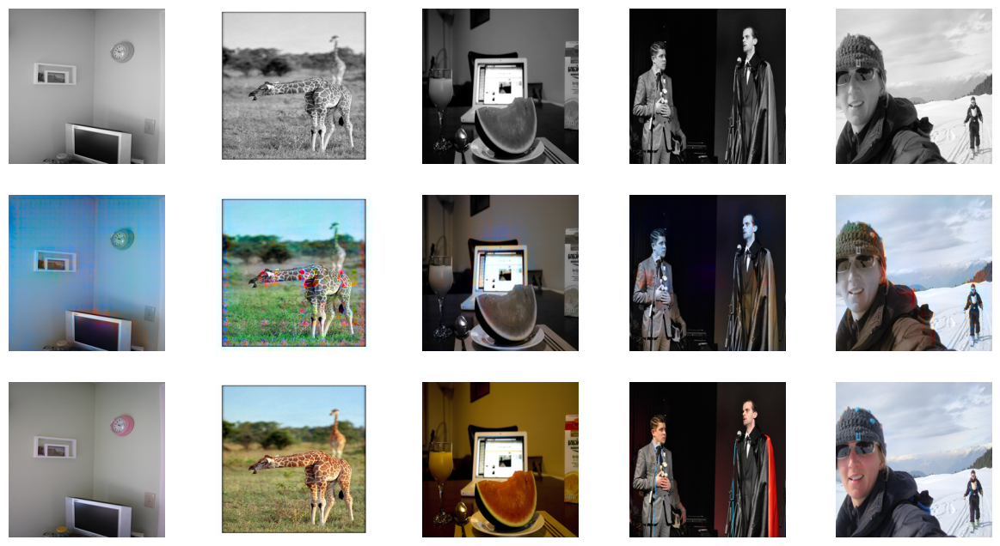


Epoch 6/10
Iteration 400/500
loss_D_fake: 0.52577
loss_D_real: 0.58742
loss_D: 0.55660
loss_G_GAN: 1.22016
loss_G_L1: 10.23090
loss_G: 11.45106


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 112 pixels
  return func(*args, **kwargs)


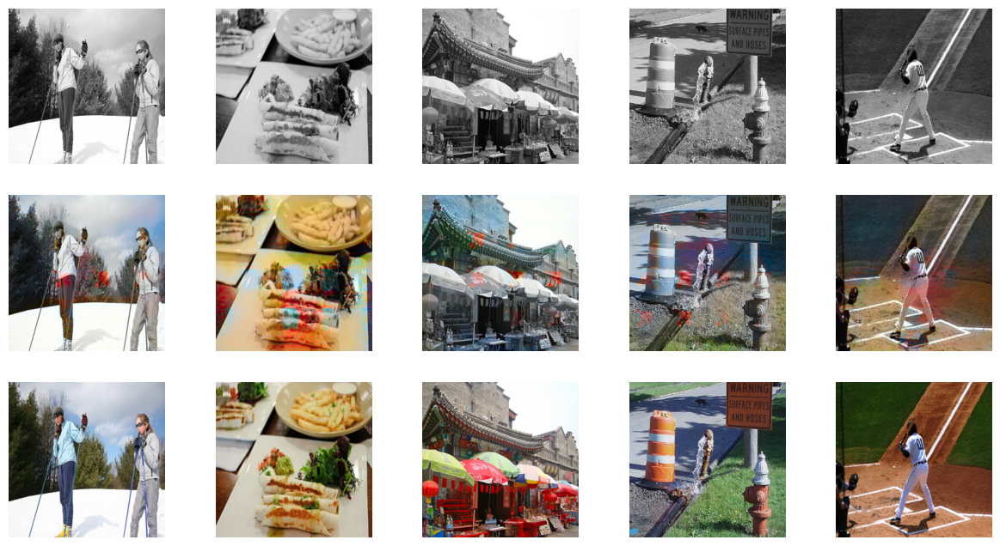

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 7/10
Iteration 200/500
loss_D_fake: 0.53463
loss_D_real: 0.60038
loss_D: 0.56751
loss_G_GAN: 1.23628
loss_G_L1: 10.14597
loss_G: 11.38225


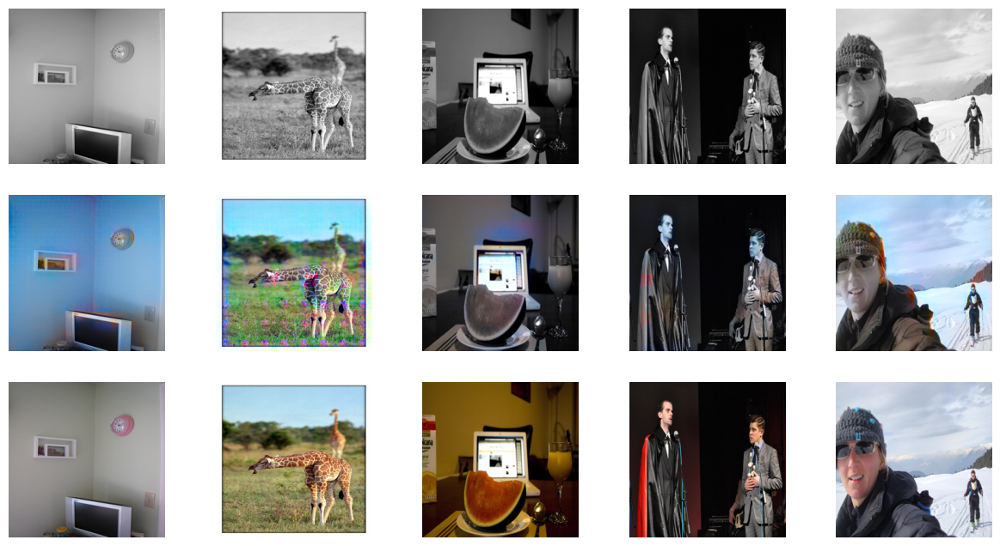


Epoch 7/10
Iteration 400/500
loss_D_fake: 0.52661
loss_D_real: 0.58077
loss_D: 0.55369
loss_G_GAN: 1.24556
loss_G_L1: 10.15663
loss_G: 11.40220


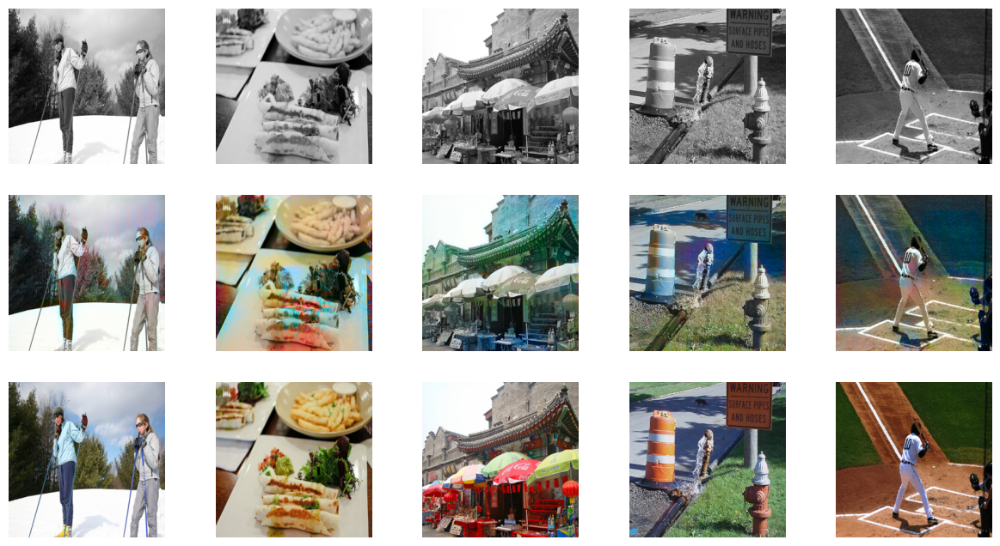

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 8/10
Iteration 200/500
loss_D_fake: 0.53380
loss_D_real: 0.58949
loss_D: 0.56164
loss_G_GAN: 1.25422
loss_G_L1: 10.07968
loss_G: 11.33390


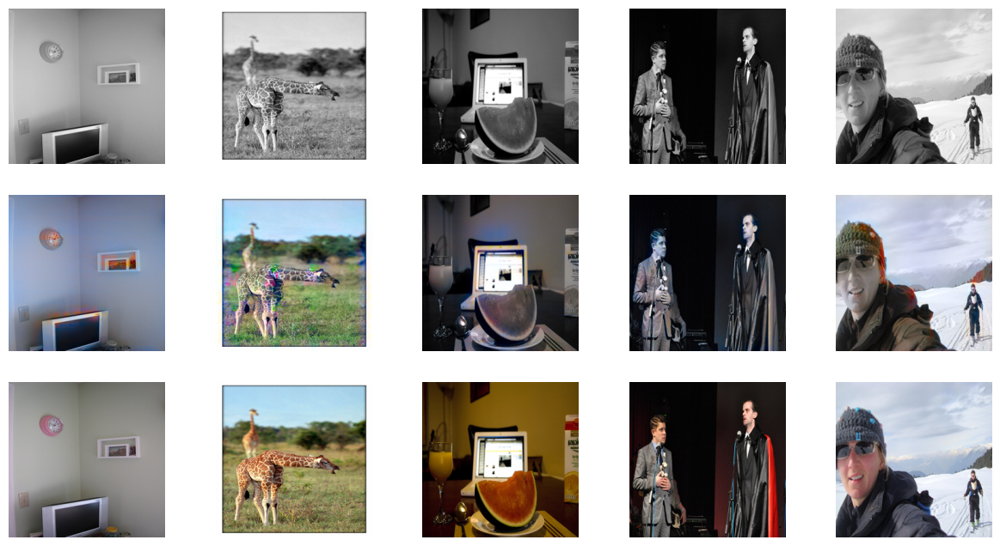


Epoch 8/10
Iteration 400/500
loss_D_fake: 0.52971
loss_D_real: 0.57922
loss_D: 0.55447
loss_G_GAN: 1.25012
loss_G_L1: 10.09312
loss_G: 11.34324


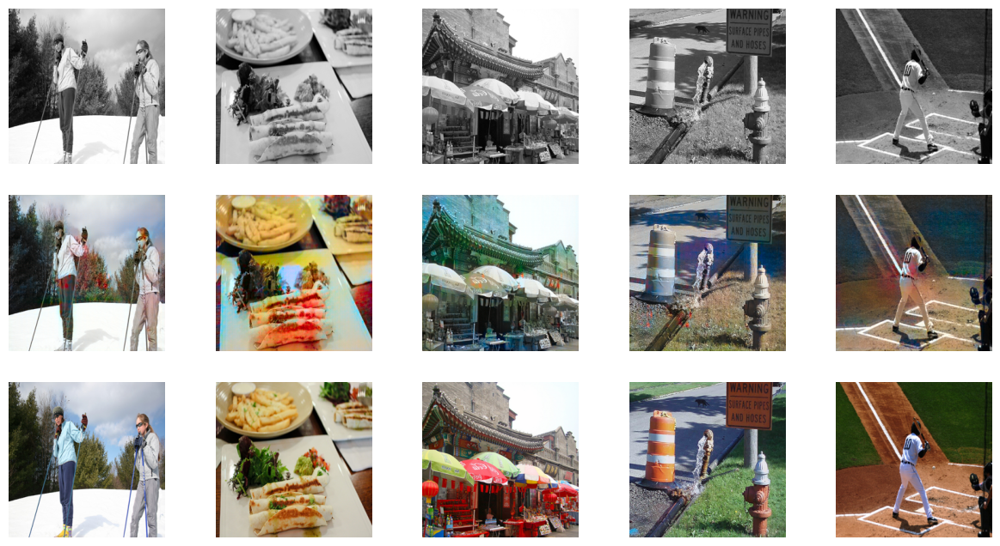

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 9/10
Iteration 200/500
loss_D_fake: 0.53541
loss_D_real: 0.58664
loss_D: 0.56103
loss_G_GAN: 1.22670
loss_G_L1: 10.03492
loss_G: 11.26162


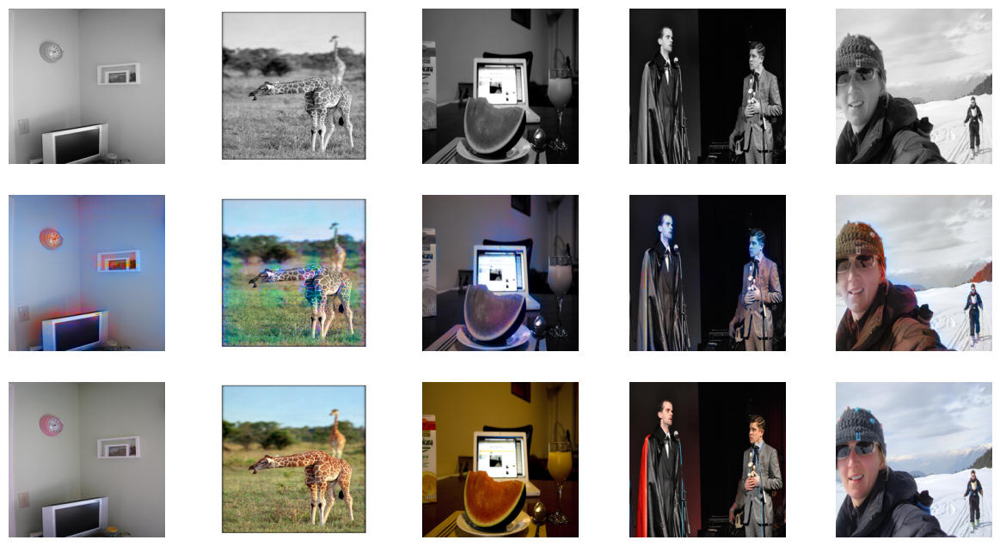


Epoch 9/10
Iteration 400/500
loss_D_fake: 0.53304
loss_D_real: 0.58166
loss_D: 0.55735
loss_G_GAN: 1.23484
loss_G_L1: 10.02229
loss_G: 11.25712


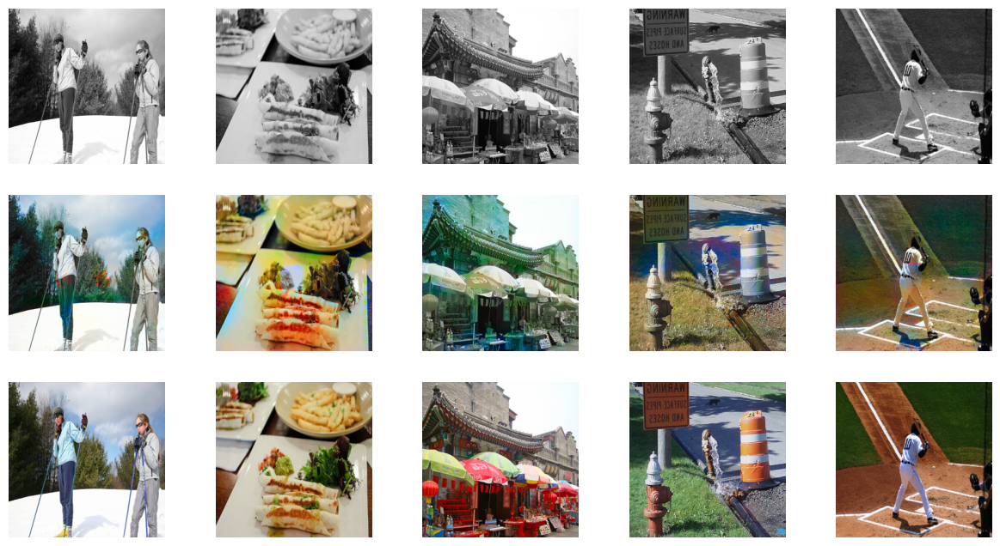

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 10/10
Iteration 200/500
loss_D_fake: 0.53215
loss_D_real: 0.58086
loss_D: 0.55650
loss_G_GAN: 1.23957
loss_G_L1: 9.89310
loss_G: 11.13267


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return func(*args, **kwargs)


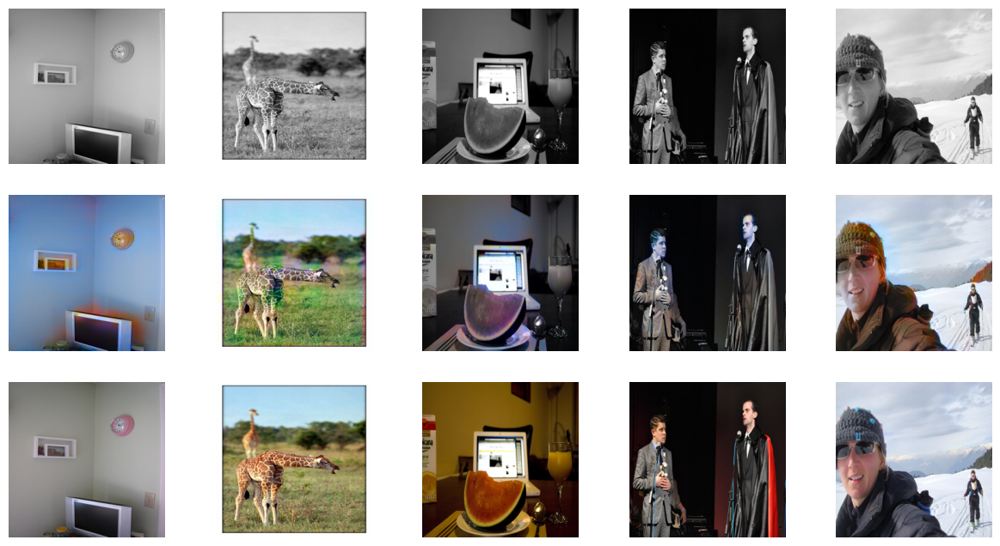


Epoch 10/10
Iteration 400/500
loss_D_fake: 0.52710
loss_D_real: 0.57345
loss_D: 0.55027
loss_G_GAN: 1.24964
loss_G_L1: 9.90800
loss_G: 11.15764


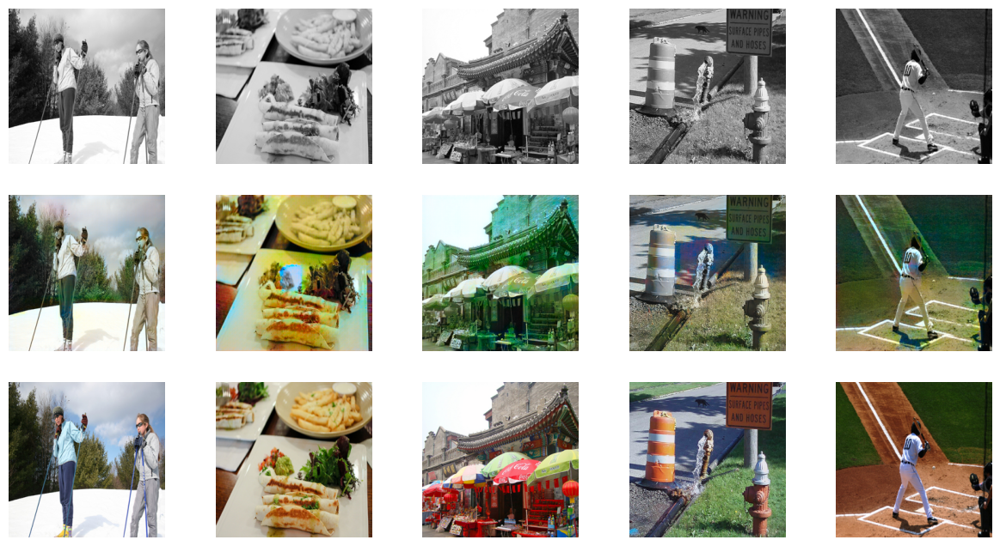

In [ ]:
train_model(model, train_dl, 10)

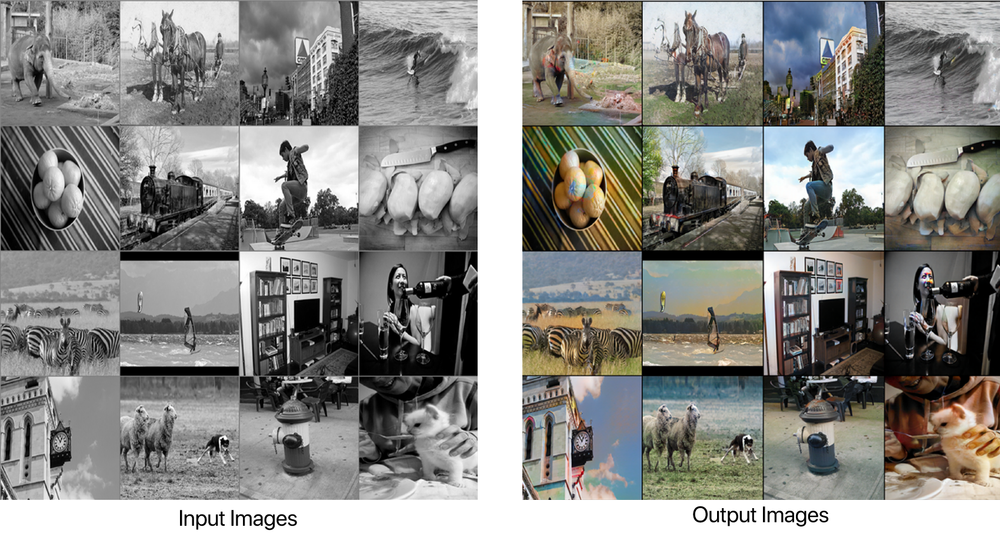OUTPUT AFTER 20 EPOCHS


As you can see, the model was easily able to identify the patterns and fill in the right colors in the right places. We can see some odd balls which didn't get a perfectly colored output but the probablity of these images turning out perfect is ~0.9 by the end of the training which is more than acceptable at this point.

This model will now be processed into an object on Jupyter Notebook (since Google Colab notebooks cannot run over 12 hours and the training for the final model will take a little over 2 weeks) which can be used in scripts for the complete project.

We'll be saving the model and rewriting it every Epoch for the convinience of being able to stop the training every few hours.



This section of the project was inspired from:<br>
[Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network](https://arxiv.org/abs/1609.04802)<br>
The idea is actually really simple. In the GAN setting that we used, neither of the agents (the generator or the discriminator) had any training about the task they will have to do, but here we decide to pre-train the generator for it's task to avoid the situation which the above mentioned research paper cites as "Blind leading Blind"

The pre-training will have two stages:

1. Using a pretrained classification model for the down sampling path of the Generator (ResNet18)
2. Pretraining the Generator for colorization with L1 loss (mean absolute error loss)

# **Using the New Generator**
Building a U-Net with a ResNet backbone sounds extremely hard and impressive but the proposed paper showed us that it really is not. Just use fastai using pip or conda and you're all good to go.

Here, the create_body function loads the pre-trained weights of ResNet18 architecture and cuts the model to remove the last two layers. Then, DynamicUnet uses this backbone to build a U-Net with an input size of 256 and a two-channel output, exactly as per our needs.

In [ ]:
! pip install fastai==2.4

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 755.5/755.5 MB 749.7 kB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-ma

In [ ]:
from fastai.vision.learner import create_body
from torchvision.models.resnet import resnet18
from fastai.vision.models.unet import DynamicUnet

def build_res_unet(n_input=1, n_output=2, size=256):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    body = create_body(resnet18, pretrained=True, n_in=n_input, cut=-2)
    net_G = DynamicUnet(body, n_output, (size, size)).to(device)
    return net_G

In [ ]:
def pretrain_generator(net_G, train_dl, opt, criterion, epochs):
    for e in range(epochs):
        loss_meter = AverageMeter()
        for data in tqdm(train_dl):
            L, ab = data['L'].to(device), data['ab'].to(device)
            preds = net_G(L)
            loss = criterion(preds, ab)
            opt.zero_grad()
            loss.backward()
            opt.step()

            loss_meter.update(loss.item(), L.size(0))

        print(f"Epoch {e + 1}/{epochs}")
        print(f"L1 Loss: {loss_meter.avg:.5f}")

net_G = build_res_unet(n_input=1, n_output=2, size=256)
opt = optim.Adam(net_G.parameters(), lr=1e-4)
criterion = nn.L1Loss()
pretrain_generator(net_G, train_dl, opt, criterion, 20)
torch.save(net_G.state_dict(), "res18-unet.pt")

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
net_G = build_res_unet(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))
model = MainModel(net_G=net_G)

In [ ]:
train_model(model, train_dl, 20)

OUTPUT AFTER 20 EPOCHS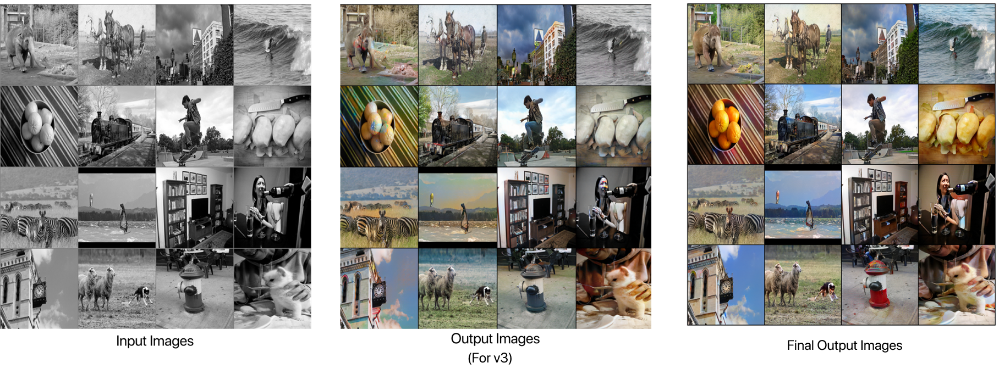

# **COMPARISON **
As you can see, some small changes were able to improve our results so much. By the end, our model was able to reach an accuracy of over 98% with the original images. We'll add comaprisons with famous models like deOldify to measure our levels of success.

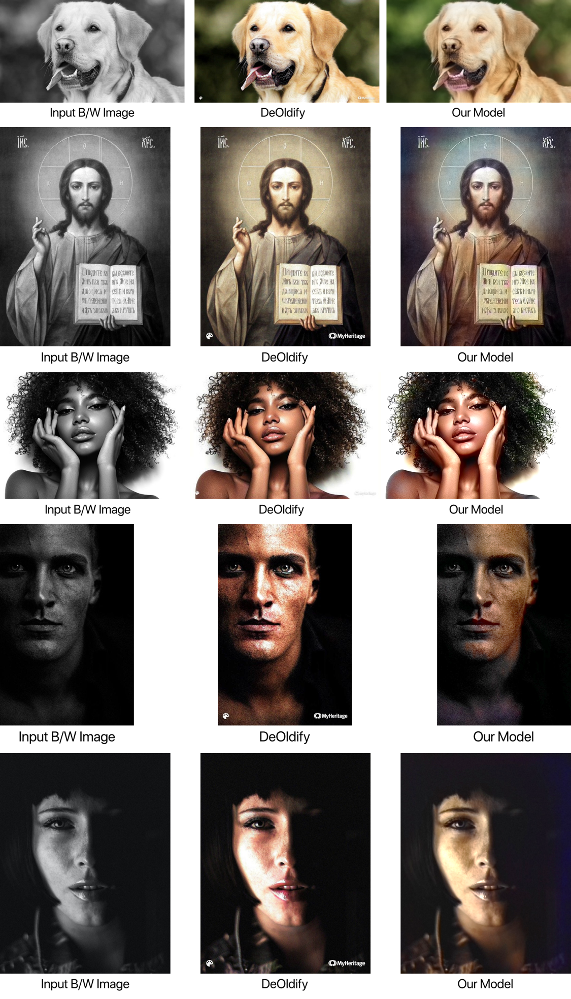